<a href="https://colab.research.google.com/github/NaithaniAR/ZOMATO-RESTAURANT-CLUSTERING-AND-SENTIMENT-ANALYSIS/blob/main/Zomato_web_Scraping_using_Beautiful_Soup_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Zomato web-Scrapping using  Beautiful Soup**

Would love to thank [Jim shaped coding](https://www.youtube.com/channel/UCU8d7rcShA7MGuDyYH1aWGg) for the amzing video on [Web Scraping with Python - Beautiful Soup Crash Course](https://www.youtube.com/watch?v=XVv6mJpFOb0&t=357s). 




[Beautiful Soup Documentation](https://beautiful-soup-4.readthedocs.io/en/latest/)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd
import numpy as np
import re

In [ ]:
meta_df = pd.read_csv('https://raw.githubusercontent.com/NaithaniAR/ZOMATO-RESTAURANT-CLUSTERING-AND-SENTIMENT-ANALYSIS/main/Zomato%20Restaurant%20names%20and%20Metadata.csv')


In [ ]:
meta_df.shape

(105, 6)

In [ ]:
pip install beautifulsoup4

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from bs4 import BeautifulSoup

In [ ]:
pip install requests

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import requests

In [ ]:
# Defining a function to scrape the content in the website and return the html script of the page(Scraping already done, so no need to run again.)

def send_request(url):
    response = requests.get(
        url='https://app.scrapingbee.com/api/v1/',
        params={
            'api_key': '^Get from the link aboove^',
            'url': url,  
        },
        
    )
    print('Response HTTP Status Code: ', response.status_code)
    print('Response HTTP Response Body: ', response.content)
    return response


In [ ]:
# Creating a new column to store the html string of each url

meta_df['content'] = np.nan


Response HTTP Status Code:  200
Response HTTP Response Body:  b'<!DOCTYPE html><html lang="en" data-rh="lang"><head>\n      <meta name="viewport" content="width=device-width, initial-scale=1">\n      <link rel="preconnect" href="https://googleads.g.doubleclick.net">\n      <link rel="preconnect" href="https://jumbo.zomato.com">\n      <link rel="preconnect" href="https://accounts.google.com">\n      <link rel="preconnect" href="https://securepubads.g.doubleclick.net">\n      <link rel="preconnect" href="https://www.google-analytics.com">\n      <link rel="preconnect" href="https://www.googleadservices.com">\n      <link rel="preconnect" href="https://bat.bing.com">\n      <link rel="preconnect" href="https://8391443.fls.doubleclick.net">\n      <title> \nBeyond Flavours, Gachibowli, Hyderabad - Restaurant\n</title>\n      <meta data-rh="true" charset="utf-8"><meta data-rh="true" name="robots" content="NOODP,NOYDIR"><meta data-rh="true" name="description" content=" \nBeyond Flavours Hyd
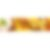
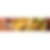
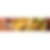
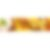
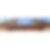
...
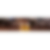
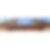
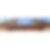
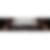
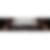

In [ ]:
# Scraping through each url and storing the html string in the content column of the data frame

for i,url in enumerate(meta_df['Links']):
  response = send_request(url)
  content = response.content
  meta_df.loc[i,'content'] = str(content)


In [ ]:
# Writing the dataframe to a csv to ensure no data loss in working

meta_df.to_csv('/content/drive/MyDrive/Raw.csv')


In [ ]:
# reading the dataframe from the csv file again to import the scraped data from the already prepared csv file
df = pd.read_csv('/content/drive/MyDrive/Raw.csv')

In [ ]:
for i, content in enumerate(df['content']):
  # updating the string to a soup string to make parsing easier
  soup = str(BeautifulSoup(df.loc[i,'content'],"html.parser"))

  # Parsing the latitude and longitude
  tmp = list(re.finditer('https://maps.zomato.com/',soup))
  if len(tmp) == 0:
    df.loc[i,'latitude'] = np.nan
    df.loc[i,'longitude'] = np.nan
  else:
    loc = tmp[0].span()[0]
    geo_loc = re.findall('=.+&map',soup[loc:loc+200])[0][1:-4]
    df.loc[i,'latitude'] = geo_loc.split(',')[0]
    df.loc[i,'longitude'] = geo_loc.split(',')[1]

  # Parsing the List of additional services( as a dictionary item in the dataframe column)
  tmp_loc = re.search("More Info",str(soup))
  if tmp_loc==None:
    df.loc[i,'additional_services'] = np.nan
  else:
    more_loc = tmp_loc.span()[0]
    tmp = soup[more_loc:]
    inds = list(re.finditer('color="#4F4F4F"',tmp))
    services = list()
    for ind in inds:
      loc = ind.span()[0]
      services.append(re.findall('>.+</p',tmp[loc:loc+50])[0][1:-3])
    df.loc[i,'additional_services'] = str(services)
    
  # Identifying if the restaurant has featured in any of the best lists of the city - binary variable = 1 if featured, 0 otherwise
  df.loc[i,'Has_Featured'] = int(len(list(re.finditer('Featured In',soup)))>0)

  # Identifying what people associate this restaurant for
  inds = list(re.finditer("People Say This Place Is Known For",str(soup)))
  if len(inds) == 0:
    df.loc[i,'known_for'] = np.nan
  else:
    ind = inds[0].span()[0]
    tmp = soup[ind:ind+500]
    df.loc[i,'known_for']=re.findall('color="#4F4F4F">.+</p><h3',tmp)[0][16:-7]
  
  # Identifying if the resturaunt has permanantly shut down 
  tmp_loc = re.search("Permanently Closed",str(soup))
  if tmp_loc==None:
    df.loc[i,'status'] = 'Open For Business'
  else:
    df.loc[i,'status'] = 'Permanently Closed'


   

In [ ]:
# Writing the dataframe to a csv to ensure no data loss in working

df.to_csv('/content/drive/MyDrive/names_df_v2.csv')

In [ ]:
# reading the dataframe from the csv file again to import the scraped data from the already prepared csv file

df = pd.read_csv('/content/drive/MyDrive/names_df_v2.csv')

In [ ]:
df.isnull().sum()

Unnamed: 0              0
Unnamed: 0.1            0
Name                    0
Links                   0
Cost                    0
Collections            54
Cuisines                0
Timings                 1
content                 0
latitude                1
longitude               1
additional_services     1
Has_Featured            0
known_for              10
status                  0
dtype: int64

In [ ]:
df.head()

,Unnamed: 0,Unnamed: 0.1,Name,Links,Cost,Collections,Cuisines,Timings,content,latitude,longitude,additional_services,Has_Featured,known_for,status
0,0,0,Beyond Flavours,https://www.zomato.com/hyderabad/beyond-flavou...,800,"Food Hygiene Rated Restaurants in Hyderabad, C...","Chinese, Continental, Kebab, European, South I...","12noon to 3:30pm, 6:30pm to 11:30pm (Mon-Sun)","b'<!DOCTYPE html><html lang=""en"" data-rh=""lang...",17.428879,78.373961,"['Home Delivery', 'Takeaway Available', 'Roman...",0.0,"Ambience and Service, Courteous Staffs, Cozy, ...",Open For Business
1,1,1,Paradise,https://www.zomato.com/hyderabad/paradise-gach...,800,Hyderabad's Hottest,"Biryani, North Indian, Chinese",11 AM to 11 PM,"b'<!DOCTYPE html><html lang=""en"" data-rh=""lang...",17.442382,78.356580,"['Home Delivery', 'Takeaway Available', 'Indoo...",1.0,"Good Food Service, Good for Large Groups, Happ...",Open For Business
2,2,2,Flechazo,https://www.zomato.com/hyderabad/flechazo-gach...,"1,300","Great Buffets, Hyderabad's Hottest","Asian, Mediterranean, North Indian, Desserts","11:30 AM to 4:30 PM, 6:30 PM to 11 PM","b'<!DOCTYPE html><html lang=""en"" data-rh=""lang...",17.435255,78.368087,"['Home Delivery', 'Takeaway Available', 'Table...",1.0,"Value of Money Food, Good for Large Groups, Co...",Open For Business
3,3,3,Shah Ghouse Hotel & Restaurant,https://www.zomato.com/hyderabad/shah-ghouse-h...,800,Late Night Restaurants,"Biryani, North Indian, Chinese, Seafood, Bever...",12 Noon to 2 AM,"b'<!DOCTYPE html><html lang=""en"" data-rh=""lang...",17.426722,78.376416,"['Home Delivery', 'Takeaway Available', 'Indoo...",1.0,"Delivered on Time, Big Restaurant, Food was Go...",Open For Business
4,4,4,Over The Moon Brew Company,https://www.zomato.com/hyderabad/over-the-moon...,"1,200","Best Bars & Pubs, Food Hygiene Rated Restauran...","Asian, Continental, North Indian, Chinese, Med...","12noon to 11pm (Mon, Tue, Wed, Thu, Sun), 12no...","b'<!DOCTYPE html><html lang=""en"" data-rh=""lang...",17.440155,78.361936,"['Home Delivery', 'Full Bar Available', 'Free ...",1.0,"Music and Feel, Good Food and Good Service, Am...",Open For Business


there seem to be an error in the scraped data so just imputing the values manually 

In [ ]:
df[df['Timings'].isnull()]

,Unnamed: 0,Unnamed: 0.1,Name,Links,Cost,Collections,Cuisines,Timings,content,latitude,longitude,additional_services,Has_Featured,known_for,status


From a simple visit to [zomato](https://www.zomato.com/hyderabad/pot-pourri-gachibowli)  

In [ ]:
df.iloc[30,7]='12noon – 4pm (Mon-Sun)'  


From a simple [google search](https://www.google.com/maps/place/SkyHy+Live/@17.4352222,78.3668695,19z/data=!4m13!1m7!3m6!1s0x0:0x4e22158ffc43bcd!2zMTfCsDI2JzA2LjgiTiA3OMKwMjInMDIuNyJF!3b1!8m2!3d17.4352172!4d78.3674274!3m4!1s0x3bcb93117463b87f:0xc4776227888c01f1!8m2!3d17.4353131!4d78.368218)  and [zomato](https://www.zomato.com/hyderabad/skyhy-live-gachibowli) 

In [ ]:
df[df['latitude'].isnull()]

,Unnamed: 0,Unnamed: 0.1,Name,Links,Cost,Collections,Cuisines,Timings,content,latitude,longitude,additional_services,Has_Featured,known_for,status


In [ ]:
df.iloc[24,9]= 17.4352222

In [ ]:
df.iloc[24,10]= 78.3668695

In [ ]:
df[df['additional_services'].isnull()]

,Unnamed: 0,Unnamed: 0.1,Name,Links,Cost,Collections,Cuisines,Timings,content,latitude,longitude,additional_services,Has_Featured,known_for,status
24,24,24,SKYHY,https://www.zomato.com/hyderabad/skyhy-gachibowli,"1,400","Live Sports Screenings, Gigs and Events","North Indian, Chinese, Continental","12 Noon to 12 Midnight (Mon-Thu, Sun), 12 Noon...","b'<!DOCTYPE html><html lang=""en"" data-rh=""lang...",17.435222,78.36687,NaN,0.0,NaN,Open For Business


In [ ]:
txt = 'Home Delivery  Takeaway Available  Full Bar Available  Valet Parking Available  Live Music  Romantic Dining  Happy Hours  Buffet  Dance Floor  Indoor Seating'

x = txt.split()

print(x)

df.iloc[24,11]= str(x)


['Home', 'Delivery', 'Takeaway', 'Available', 'Full', 'Bar', 'Available', 'Valet', 'Parking', 'Available', 'Live', 'Music', 'Romantic', 'Dining', 'Happy', 'Hours', 'Buffet', 'Dance', 'Floor', 'Indoor', 'Seating']


In [ ]:
df['known_for'].str.len().describe()


count     95.000000
mean      96.926316
std       51.250997
min       45.000000
25%       75.500000
50%       87.000000
75%      100.500000
max      340.000000
Name: known_for, dtype: float64

lets check for irregularities 

In [ ]:
df[df['known_for'].str.len()>=150]['known_for']

6     Healthy Food, Meals, Packing, Excellent Food, ...
7     Good Delivery, Quick Delivery, Excellent Taste...
28    Good Packaging, Packing, Portion, Food Taste, ...
74    Packing, Nice Food, Food Quality, Great Portio...
Name: known_for, dtype: object

In [ ]:
df.iloc[6,14]

'Open For Business'

we observe that there are unwanted elements 

In [ ]:
#Storinng index values 

val=[6,7,28,74]

In [ ]:
# Dropping unwanted elements off 


a=df[df['known_for'].str.len()>=150]['known_for']
list(a)
x=0 

#creating a list of size 4
mylist=[0]*4


for i in enumerate(a):  
   b = str(i[1])
   c=b.split("</p>")    
   mylist[x]=str(c[0])
    
   x=x+1
print(mylist)

x=0
for i in val:
  df.iloc[i,14]= mylist[x]
  x+=1  


['Healthy Food, Meals, Packing, Excellent Food, Quantity, Menu', 'Good Delivery, Quick Delivery, Excellent Taste, Fast Delivery, Combo, Great Taste', 'Good Packaging, Packing, Portion, Food Taste, Tasty, Quality', 'Packing, Nice Food, Food Quality, Great Portions, Timely Service, Prices']


In [ ]:
df.isnull().sum()

Unnamed: 0              0
Unnamed: 0.1            0
Name                    0
Links                   0
Cost                    0
Collections            54
Cuisines                0
Timings                 0
content                 0
latitude                0
longitude               0
additional_services     0
Has_Featured            0
known_for              10
status                  0
dtype: int64

We know that Collections is similar to known_for hence we will fill null values of fill with collections. and then drop the collections column as it has more than 50 % null values.  




In [ ]:
df['known_for']=df.known_for.fillna(df.Collections).to_frame(name='Known_for')

In [ ]:
df.drop(['Unnamed: 0','Unnamed: 0.1','content','Links','Collections'],axis =1 ,inplace = True)

In [ ]:
df[df['known_for'].isnull()]

,Name,Cost,Collections,Cuisines,Timings,latitude,longitude,additional_services,Has_Featured,known_for,status
30,Pot Pourri,900,NaN,"Andhra, South Indian, North Indian",12noon – 4pm (Mon-Sun),17.442573,78.354857,[],0.0,NaN,Permanently Closed
40,Frio Bistro,"1,200",NaN,"European, Italian, Continental, Spanish",12noon to 11pm (Mon-Sun),17.429246,78.373874,[],0.0,NaN,Permanently Closed
45,Owm Nom Nom,900,NaN,"Chinese, Biryani, Andhra, North Indian",12Noon to 11:30PM (Mon-Sun),17.448747,78.357501,[],0.0,NaN,Permanently Closed
86,The Chocolate Room,600,NaN,"Cafe, Desserts",10 AM to 12 Midnight,17.441675,78.358135,[],0.0,NaN,Permanently Closed
89,Mohammedia Shawarma,150,NaN,"Street Food, Arabian",1 PM to 1 AM,17.446976,78.353163,[],0.0,NaN,Permanently Closed
100,IndiBlaze,600,NaN,"Fast Food, Salad",11 AM to 11 PM,17.448603,78.361134,[],0.0,NaN,Permanently Closed


In [ ]:
df[df['status']=='Permanently Closed'].shape

(24, 11)

In [ ]:
df.isnull().sum()

Name                    0
Cost                    0
Collections            54
Cuisines                0
Timings                 0
latitude                0
longitude               0
additional_services     0
Has_Featured            0
known_for               6
status                  0
dtype: int64

We see that 6 null values associated with "Known_for" are for resturants which are permanatly closed. Since the scope for this notebook is only limited to web scrapping and dataset creation. lets export the dataset to the main file. 

In [ ]:
# Writing the dataframe to a csv to ensure no data loss in working

df.to_csv('/content/drive/MyDrive/new_meta.csv')